In [1]:
import pandas as pd
import plotly 
import plotly.graph_objs as go 
import seaborn as sns
import numpy as np
from urllib.request import urlopen
import json
import plotly.express as px 

In [2]:
df = pd.read_csv('donneebrute/caracteristiques_2005.csv', sep = ',', encoding='latin-1')
df1 = pd.read_csv('donneebrute/lieux_2005.csv', sep = ',', encoding='latin-1')
df2 = pd.read_csv('donneebrute/vehicules_2005.csv', sep = ',',  encoding='latin-1')
df3 = pd.read_csv('donneebrute/usagers_2005.csv', sep = ',',  encoding='latin-1')

In [3]:
df4 = df.merge(df1, how='inner')
df5 = df4.merge(df2, how='inner')
df6 = df5.merge(df3, how='inner')
df6

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,...,place,catu,grav,sexe,trajet,secu,locp,actp,etatp,an_nais
0,200500000001,5,1,12,1900,3,2,1,1,3,...,1,1,4,1,1,11,0,0,0,1976.0
1,200500000001,5,1,12,1900,3,2,1,1,3,...,1,1,3,2,3,11,0,0,0,1968.0
2,200500000001,5,1,12,1900,3,2,1,1,3,...,2,2,1,1,0,11,0,0,0,1964.0
3,200500000001,5,1,12,1900,3,2,1,1,3,...,4,2,1,1,0,31,0,0,0,2004.0
4,200500000001,5,1,12,1900,3,2,1,1,3,...,5,2,1,1,0,11,0,0,0,1998.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197491,200500087953,5,12,27,1500,1,2,3,2,5,...,1,1,1,1,0,13,0,0,0,1972.0
197492,200500087953,5,12,27,1500,1,2,3,2,5,...,1,1,4,1,5,23,0,0,0,1990.0
197493,200500087953,5,12,27,1500,1,2,3,2,5,...,1,1,1,1,0,13,0,0,0,1965.0
197494,200500087954,5,12,31,2100,5,2,1,2,7,...,1,1,4,1,0,13,0,0,0,1951.0


<AxesSubplot:xlabel='sexe'>

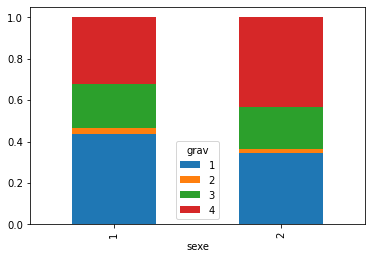

In [4]:
df7 = pd.crosstab(df6['sexe'], df6['grav'])
df7.div(df7.sum(1).astype(float), axis= 0).plot(kind = "bar", stacked = True)

<AxesSubplot:xlabel='an'>

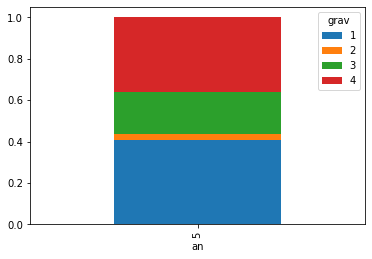

In [5]:
df8 = pd.crosstab(df6['an'], df6['grav'])
df8.div(df8.sum(1).astype(float), axis= 0).plot(kind = "bar", stacked = True)

In [6]:
df6['age'] = 2005 - df6['an_nais']
df6

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,...,catu,grav,sexe,trajet,secu,locp,actp,etatp,an_nais,age
0,200500000001,5,1,12,1900,3,2,1,1,3,...,1,4,1,1,11,0,0,0,1976.0,29.0
1,200500000001,5,1,12,1900,3,2,1,1,3,...,1,3,2,3,11,0,0,0,1968.0,37.0
2,200500000001,5,1,12,1900,3,2,1,1,3,...,2,1,1,0,11,0,0,0,1964.0,41.0
3,200500000001,5,1,12,1900,3,2,1,1,3,...,2,1,1,0,31,0,0,0,2004.0,1.0
4,200500000001,5,1,12,1900,3,2,1,1,3,...,2,1,1,0,11,0,0,0,1998.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
197491,200500087953,5,12,27,1500,1,2,3,2,5,...,1,1,1,0,13,0,0,0,1972.0,33.0
197492,200500087953,5,12,27,1500,1,2,3,2,5,...,1,4,1,5,23,0,0,0,1990.0,15.0
197493,200500087953,5,12,27,1500,1,2,3,2,5,...,1,1,1,0,13,0,0,0,1965.0,40.0
197494,200500087954,5,12,31,2100,5,2,1,2,7,...,1,4,1,0,13,0,0,0,1951.0,54.0


In [7]:
fig = go.Bar(
            x = df6['age'],
            y = df6['grav'],
            name = 'gravité',
            marker = dict(color = 'rgb(20,10,40)' ,
                         line = dict(color ='rgb(0,0,0)',width =1.5)))
data = [fig]
layout = go.Layout(barmode = "group",
                   title= "gravité d'accident par les ages",
                   xaxis=dict(title='Age'),
                   yaxis=dict( title="Nombre D'usager"))
fig = go.Figure(data = data, layout = layout)


In [8]:
fig

In [9]:
names=['code_departement', 'nom_departement', 'code_region', 'nom_region']
df9 = pd.read_csv('departements-france.csv',
                                header=None, skiprows=[0], names=names)

df6['dep'] = df6['dep'].astype('int')
df6 = df6.sort_values(by='dep', ascending = True)
df6['dep']=df6.dep//10


df10 = pd.DataFrame(df9[['code_departement','nom_departement','code_region', 'nom_region']])

df11 = pd.concat([df6, df10], axis =1)
df12 = df11.groupby('dep')['grav'].count()
df12
df11['count_grav'] = df12
df11
with urlopen('https://france-geojson.gregoiredavid.fr/repo/departements.geojson') as response:
        geojson = json.load(response)
fig = px.choropleth_mapbox(df11,geojson= geojson
                       ,color= "count_grav"
                       ,locations="code_departement"
                       ,featureidkey="properties.code"
                       ,hover_name = 'nom_departement'
                       , color_continuous_scale = [(0,"purple"), (1,"red")]
                       #,color_continuous_midpoint = 4
                       ,range_color = (0, 2000)
                       ,title="NOMBRE TOTALE D'USAGERS ACCIDENTÉS PAR DEPARTEMENT" 
                       ,center={"lat": 46.3223, "lon": 1.2549}
                       ,mapbox_style="carto-positron", zoom=4.5)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})